# Rs. 500 currency testing using SSIM

In [2]:
pip install cv2

Note: you may need to restart the kernel to use updated packages.


ERROR: Could not find a version that satisfies the requirement cv2 (from versions: none)
ERROR: No matching distribution found for cv2


In [3]:
 pip install --upgrade pip

Note: you may need to restart the kernel to use updated packages.


This notebook carries out the complete evaluation of an input Rs. 500 currency note

In [4]:
pip install opencv-python

Note: you may need to restart the kernel to use updated packages.


In [5]:
pip install scikit-image matplotlib

Note: you may need to restart the kernel to use updated packages.


In [ ]:


import cv2                            
import numpy as np                    
import matplotlib.pyplot as plt       
from skimage.metrics import structural_similarity as ssim   


from tkinter import *
from tkinter.ttk import Progressbar

import time


plt.rcParams["figure.figsize"] = (12, 12)

In [ ]:

myProgress =0.0

In [ ]:

path = r'G:\Fake-Currency-Detection-System\Project_files\Dataset\500_dataset\500_s1.jpg'

import os
if os.path.exists(path):
    print("File exists.")
else:
    print("File does not exist.")


import cv2
test_img = cv2.imread(path)
if test_img is None:
    print("Failed to read the image. Please check the path.")
else:
    print("Image loaded successfully.")

File exists.
Image loaded successfully.


In [ ]:

if test_img is None:
    print("Error: Could not load the image. Check the file path and ensure the image exists and is valid.")
    exit() 
else:
    print(f"Image loaded successfully. Shape: {test_img.shape}")
    print(f"Image data type: {test_img.dtype}")


test_img_resized = cv2.resize(test_img, (1167, 519)) 
print("Image resized successfully.")

test_img = cv2.resize(test_img, (1167, 519))
blur_test_img = cv2.GaussianBlur(test_img, (5,5), 0)


gray_test_image = cv2.cvtColor(blur_test_img, cv2.COLOR_BGR2GRAY)

def preprocessing():
    plt.imshow(gray_test_image, 'gray')
    plt.title('Input image after pre- processing')
    plt.show()
    progress['value']=5
    ProgressWin.update_idletasks()
    
    
    progress['value']=5
    ProgressWin.update_idletasks()

Image loaded successfully. Shape: (1014, 2232, 3)
Image data type: uint8
Image resized successfully.


In [ ]:

def calculateSSIM(template_img, query_img):
    min_w = min(template_img.shape[1], query_img.shape[1])
    min_h = min(template_img.shape[0], query_img.shape[0])
    
    
    img1 = cv2.resize(template_img, (min_w, min_h))
    img2 = cv2.resize(query_img, (min_w, min_h))
    
    
    img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
    img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)
    
    
    plt.subplot(1, 2, 1)
    plt.imshow(img1, 'gray')

    plt.subplot(1, 2, 2)
    plt.imshow(img2, 'gray')

    plt.show()
    
    
    score = ssim(img1, img2)
    return score

In [ ]:


def computeORB(template_img, query_img):


    nfeatures=700;
    scaleFactor=1.2;
    nlevels=8;
    edgeThreshold=15; 
    orb = cv2.ORB_create(
        nfeatures,
        scaleFactor,
        nlevels,
        edgeThreshold)
    
    
    kpts1, descs1 = orb.detectAndCompute(template_img,None)
    kpts2, descs2 = orb.detectAndCompute(query_img,None)
    
    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

    
    matches = bf.match(descs1, descs2)

    
    dmatches = sorted(matches, key = lambda x:x.distance
    src_pts  = np.float32([kpts1[m.queryIdx].pt for m in dmatches]).reshape(-1,1,2)
    dst_pts  = np.float32([kpts2[m.trainIdx].pt for m in dmatches]).reshape(-1,1,2)

    
    M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC,5.0)
    h,w = template_img.shape[:2]
    pts = np.float32([ [0,0],[0,h-1],[w-1,h-1],[w-1,0] ]).reshape(-1,1,2)
    
    if M is not None:
        dst = cv2.perspectiveTransform(pts,M)
    else:
        dst = None

    
    return dst, dst_pts, kpts1, kpts2, dmatches

In [ ]:

search_area_list = [[200,300,200,370],
                    [1050,1500,300,450],
                    [100,450,20,120],
                    [690,1050,20,120],
                    [820,1050,350,430],
                    [700,810,330,430],
                    [400,650,0,100]]



feature_area_limits_list = [[12000,17000],
                            [10000,18000],
                            [20000,30000],
                            [24000,36000],
                            [15000,25000],
                            [7000,13000],
                            [11000,18000]]

score_set_list = []               
best_extracted_img_list = []      
avg_ssim_list = []                
NUM_OF_FEATURES = 7              

In [ ]:


def testFeature_1_2_7():
    i = 0
    j = 0
    NUMBER_OF_TEMPLATES = 6 
    global score_set_list                
    global best_extracted_img_list       
    global avg_ssim_list                 

    
    
    global myProgress
    myProgress =progress['value']

    
    
    for j in range(NUM_OF_FEATURES):
        print('ANALYSIS OF FEATURE ' + str(j+1))

        score_set = []           
        max_score = -1           
        max_score_img = None     
        for i in range(NUMBER_OF_TEMPLATES):
            print('---> Template ' + str(i+1) + ' :')
            template_path = r'Dataset\500_Features Dataset\Feature ' + str(j+1) + '\\' + str(i+1) + '.jpg'

            template_img = cv2.imread(template_path)

            template_img_blur = cv2.GaussianBlur(template_img, (5,5), 0)
            template_img_gray = cv2.cvtColor(template_img_blur, cv2.COLOR_BGR2GRAY)

            test_img_mask = gray_test_image.copy()

            
            search_area = search_area_list[j]

            test_img_mask[:, :search_area[0]] = 0
            test_img_mask[:, search_area[1]:] = 0
            test_img_mask[:search_area[2], :] = 0
            test_img_mask[search_area[3]:, :] = 0

            
            dst, dst_pts, kpts1, kpts2, dmatches = computeORB(template_img_gray, test_img_mask)

            
            if dst is None:
                print('An Error occurred - Homography matrix is of NoneType')
                continue

            query_img = test_img.copy()

        
            res_img1 = cv2.polylines(query_img, [np.int32(dst)], True, (0,0,255), 1, cv2.LINE_AA)

            
            res_img2 = cv2.drawMatches(template_img, kpts1, res_img1, kpts2, dmatches[:20],None,flags=2)

            
            (x, y, w, h) = cv2.boundingRect(dst) 
            min_area = feature_area_limits_list[j][0]
            max_area = feature_area_limits_list[j][1]

            feature_area = w*h
            if feature_area < min_area or feature_area > max_area:
                (x, y, w, h) = cv2.boundingRect(dst_pts) 

                feature_area = w*h
                if feature_area < min_area or feature_area > max_area: 
                    print('Template Discarded- Area of extracted feature is outside permitted range!')
                    continue

            
            cv2.rectangle(res_img1, (x,y), (x+w, y+h), (0,255,0), 3)

            # Plotting images
            plt.rcParams["figure.figsize"] = (16, 16)
            plt.subplot(1, 2, 1)
            plt.imshow(res_img2, 'gray')

            plt.subplot(1, 2, 2)
            plt.imshow(res_img1, 'gray')
            plt.show()

            
            crop_img = blur_test_img[y:y+h, x:x+w]

            plt.rcParams["figure.figsize"] = (5, 5)
            score = calculateSSIM(template_img_blur, crop_img)

            score_set.append(score)
            print('SSIM score: ', score, '\n')

            
            if score > max_score:
                max_score = score
                max_score_img = crop_img
            
            
            myProgress = myProgress + (75.0/(NUM_OF_FEATURES*NUMBER_OF_TEMPLATES))
            progress['value'] = myProgress 
            ProgressWin.update_idletasks()
            
        
        score_set_list.append(score_set)
        print('SSIM score set of Feature ' + str(j+1) + ': ', score_set, '\n')

        avg_ssim_list.append(sum(score_set)/len(score_set))
        print('Average SSIM of Feature ' + str(j+1) + ': ',sum(score_set)/len(score_set),'\n')
        
        if len(score_set) != 0:
            avg_ssim_list.append(sum(score_set)/len(score_set))
            print('Average SSIM of Feature ' + str(j+1) + ': ',sum(score_set)/len(score_set),'\n')
        else:
            print('No SSIM scores were found for this feature!')
            avg_ssim_list.append(0.0)
            print('Average SSIM of Feature ' + str(j+1) + ': 0','\n')

        best_extracted_img_list.append([max_score_img, max_score])

    print('Final Score- set list:','\n')

    for x in range(len(score_set_list)):
        print('Feature',x+1,':',score_set_list[x])
    print('\n')

    print('Final Average SSIM list for each feature:','\n')

    for x in range(len(avg_ssim_list)):
        print('Feature',x+1,':',avg_ssim_list[x])


In [14]:
left_BL_result = []
right_BL_result = []
result_list = []
number_panel_result = []

# Left Bleed Lines feature extraction

In [ ]:


def testFeature_8():
    plt.rcParams["figure.figsize"] = (5, 5)

    
    print('\nANALYSIS OF FEATURE 8 : LEFT BLEED LINES\n')

    
    crop = test_img[120:240, 12:35]

    img = crop.copy()
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    _, thresh = cv2.threshold(gray, 130, 255, cv2.THRESH_BINARY)

    plt.imshow(thresh, 'gray')
    plt.show()

    whitePixelValue = 255        
    blackPixelValue = 0        

    width = thresh.shape[1]    
    result = []                
    num_of_cols = 0            

    print('Number of black regions found in each column: ')

    
    for j in range(width):
        col =thresh[:, j:j+1]     
        count = 0                 

        
        for i in range(len(col)-1):

        
            pixel1_value = col[i][0]
            pixel2_value = col[i+1][0]

        
            if pixel1_value != 0 and pixel1_value != 255:
                pixel1_value = 255
            if pixel2_value != 0 and pixel2_value != 255:
                pixel2_value = 255

            if pixel1_value == whitePixelValue and pixel2_value == blackPixelValue:
                count += 1

    
        if count > 0 and count < 10:
            print(count)
            result.append(count)
            num_of_cols += 1
        else:
            print(count, 'Erroneous -> discarded')

    
    print('\nNumber of columns examined: ', width)
    print('Number of non- erroneous columns found: ', num_of_cols)

    if num_of_cols != 0:
        average_count = sum(result)/num_of_cols
    else:
        average_count = -1
        print('Error occured- Division by 0')

    print('\nAverage number of black regions is: ', average_count)


    global left_BL_result
    left_BL_result = [thresh, average_count]
    
    
    global myProgress
    progress['value']=80
    ProgressWin.update_idletasks()

# Right Bleed Lines feature extraction

In [ ]:


def testFeature_9():
    plt.rcParams["figure.figsize"] = (5, 5)

    print('\nANALYSIS OF FEATURE 9 : RIGHT BLEED LINES\n')

    
    crop = test_img[120:260, 1135:1155]

    img = crop.copy()
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    

    _, thresh = cv2.threshold(gray, 130, 255, cv2.THRESH_BINARY)

    plt.imshow(thresh, 'gray')
    plt.show()

    whitePixelValue = 255      
    blackPixelValue = 0     

    width = thresh.shape[1]    
    result = []                
    num_of_cols = 0            

    print('Number of black regions found in each column: ')

    for j in range(width):
        col =thresh[:, j:j+1]    
        count = 0                 

    
        for i in range(len(col)-1):

        
            pixel1_value = col[i][0]
            pixel2_value = col[i+1][0]


            if pixel1_value != 0 and pixel1_value != 255:
                pixel1_value = 255
            if pixel2_value != 0 and pixel2_value != 255:
                pixel2_value = 255


            if pixel1_value == whitePixelValue and pixel2_value == blackPixelValue:
                count += 1

        if count > 0 and count < 10:
            print(count)
            result.append(count)
            num_of_cols += 1
        else:
            print(count, 'Erroneous -> discarded')


    print('\nNumber of columns examined: ', width)
    print('Number of non- erroneous columns found: ', num_of_cols)

    if num_of_cols != 0:
        average_count = sum(result)/num_of_cols
    else:
        average_count = -1
        print('Error occured- Division by 0')

    print('\nAverage number of black regions is: ', average_count)


    global right_BL_result
    right_BL_result = [thresh, average_count]
    global myProgress
    

    progress['value']=85
    ProgressWin.update_idletasks()

# Currency Number Panel

In [ ]:


crop = gray_test_image[410:500, 700:1080]            
crop_bgr = test_img[410:500, 700:1080]        



In [ ]:


def testFeature_10():
    plt.imshow(crop_bgr)
    plt.show()

    plt.rcParams["figure.figsize"] = (7, 7)

    print('\nANALYSIS OF FEATURE 10 : NUMBER PANEL \n')

    test_passed = False        
    res_img_list = []         
    count = 0                  
    i = 0


    for thresh_value in range(95, 155, 5):
        
        _, thresh = cv2.threshold(crop, thresh_value, 255, cv2.THRESH_BINARY)

        print('---> Threshold ' + str(i+1) + ' with Threshold value ' + str(thresh_value) + ' :')
        i += 1

        copy = crop_bgr.copy()

    
        img = cv2.bitwise_and(crop, crop, mask=thresh)
        contours, hierarchy = cv2.findContours(img, cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)

        h_img, w_img = img.shape[:2]

        
        bounding_rect_list = []    

        for contour in contours:
            [x, y, w, h] = cv2.boundingRect(contour)

            if x != 0:
                bounding_rect_list.append([x,y,w,h])

        
        bounding_rect_list.sort()


        min_area = 150
        res_list = []

        
        for i in range(0, len(bounding_rect_list)):
            if i>= len(bounding_rect_list):
                break
            if bounding_rect_list[i][2]*bounding_rect_list[i][3] > min_area:
                res_list.append(bounding_rect_list[i])

        
        i = 0
        while i<len(res_list):
            [x,y,w,h] = res_list[i]
            j = i+1
            while j<len(res_list):
                [x0,y0,w0,h0] = res_list[j]

                if (x+w) >= x0+w0:
                    res_list.pop(j)
                else:
                    break
            i+= 1

        
        i = 0
        while i<len(res_list):
            [x,y,w,h] = res_list[i]

            if (h_img-(y+h)) > 40:    
                res_list.pop(i)
            elif h<17:
                res_list.pop(i)          
            else:
                i += 1

        for rect in res_list:          
            [x,y,w,h] = rect
            cv2.rectangle(copy, (x, y), (x + w, y + h), (0, 0, 255), 1)        

        
        if len(res_list) == 9:         
            test_passed = True
            res_img_list.append(copy)
            count += 1
            print('Test Successful: 9 letters found!')
        else:
            print('Unsuccessful!')


        
        if count == 3:
            break

    if count == 0:                    
        best_img = crop_bgr
    elif count == 1:                  
        best_img = res_img_list[0]
    elif count == 2:                  
        best_img = res_img_list[1]
    else:                             
        best_img = res_img_list[2]
    
    

    if(test_passed):
        print('Test Passed!- 9 characters were detected in the serial number panel.')
        plt.imshow(best_img)
        plt.show()
    else:
        print('Test Failed!- 9 characters were NOT detected in the serial number panel.')

    global number_panel_result
    number_panel_result = [best_img, test_passed]
    
    global myProgress
    progress['value']=90
    ProgressWin.update_idletasks()

# Results

In [ ]:


def testResult():
    plt.rcParams["figure.figsize"] = (3, 3)

    print('\n\nRESULT ANALYSIS\n')

    
    min_ssim_score_list = [0.4, 0.4, 0.5, 0.4, 0.5, 0.45, 0.5]

    global result_list
    result_list = []          
    successful_features_count = 0  

    for i in range(NUM_OF_FEATURES):
        avg_score = avg_ssim_list[i]
        img, max_score = best_extracted_img_list[i]
        status = False
        min_allowed_score = min_ssim_score_list[i]

        if avg_score >= min_allowed_score or max_score >= 0.79:
            status = True
            successful_features_count += 1
            print('Feature ' + str(i+1) + ': Successful')
        else:
            status = False
            print('Feature ' + str(i+1) + ': Unsuccessful')
        
        if img is None:
            img = cv2.imread('Image_not_found.jpg')
        
        result_list.append([img, avg_score, max_score, status])

        

    img, line_count = left_BL_result[:]

    if line_count >= 4.7 and line_count <= 5.6:
        status = True
        successful_features_count += 1
        print('Feature 8: Successful- 5 bleed lines found in left part of currency note')
    else:
        status = False
        print('Feature 8: Unsuccessful!')
    
    if img is None:
        img = cv2.imread('Image_not_found.jpg')
    result_list.append([img, line_count, status])


    img, line_count = right_BL_result[:]

    
    if line_count >= 4.7 and line_count <= 5.6:
        status = True
        successful_features_count += 1
        print('Feature 9: Successful- 5 bleed lines found in right part of currency note')
    else:
        status = False
        print('Feature 9: Unsuccessful!')
    
    if img is None:
        img = cv2.imread('Image_not_found.jpg')
    result_list.append([img, line_count, status])


    img, status = number_panel_result[:]


    if status:
        successful_features_count += 1
        print('Feature 10: Successful- 9 characters found in number panel of currency note')
    else:
        print('Feature 10: Unsuccessful!')
    
    if img is None:
        img = cv2.imread('Image_not_found.jpg')
    result_list.append([img, status])

    

    print('\nResult Summary:')
    print(str(successful_features_count) + ' out of 10 features are VERIFIED!')
    
    
    global myProgress
    progress['value']=97
    ProgressWin.update_idletasks()

# Driver cell

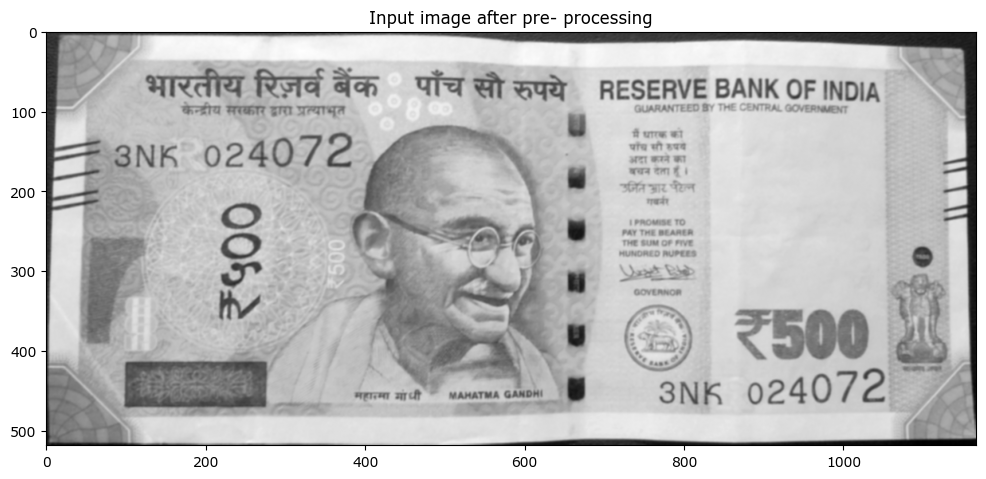

ANALYSIS OF FEATURE 1
---> Template 1 :


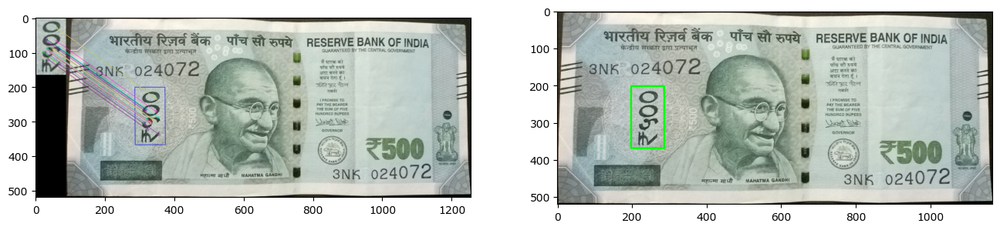

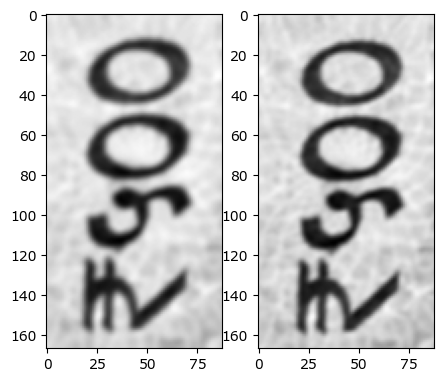

SSIM score:  0.8912461747428234 

---> Template 2 :


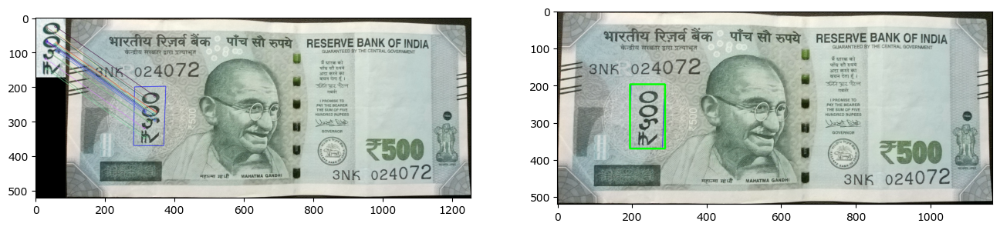

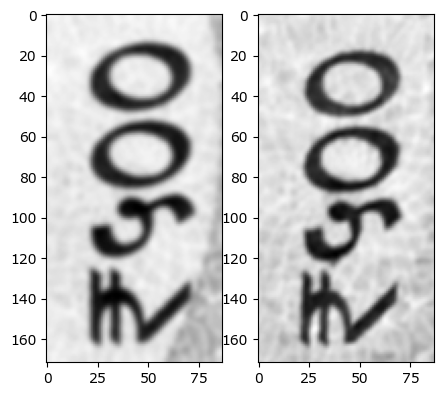

SSIM score:  0.5593300631270272 

---> Template 3 :


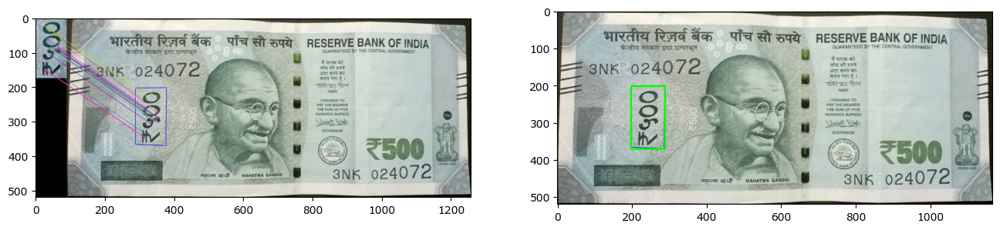

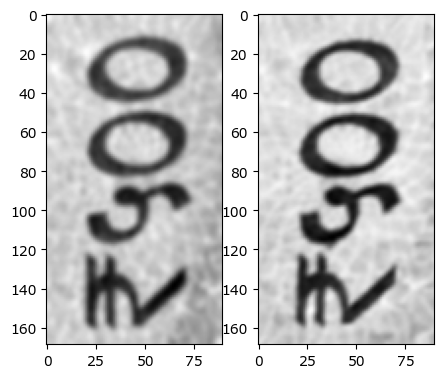

SSIM score:  0.6664040505847512 

---> Template 4 :


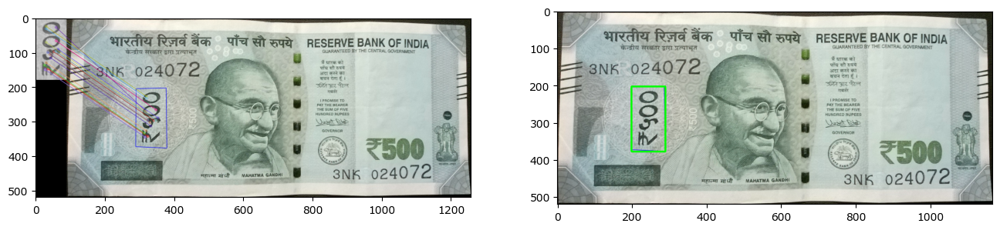

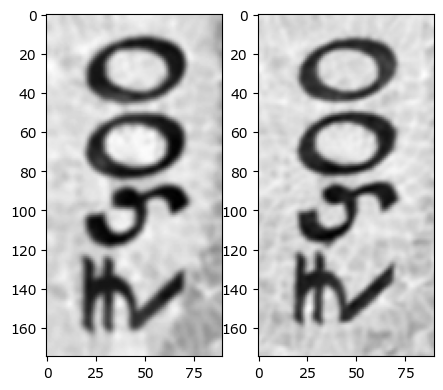

SSIM score:  0.6833000133892703 

---> Template 5 :


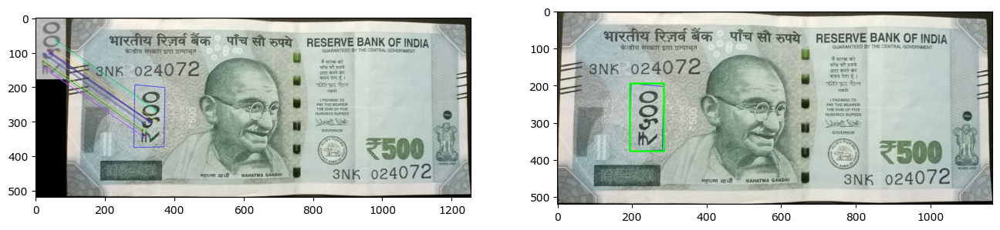

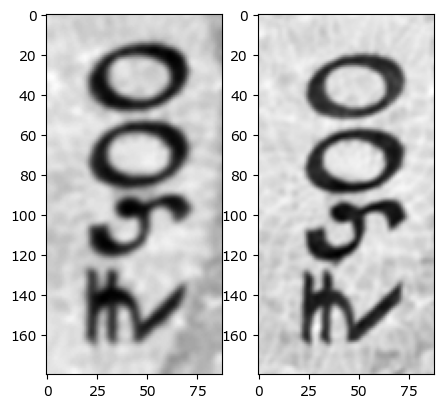

SSIM score:  0.5754926361671558 

---> Template 6 :


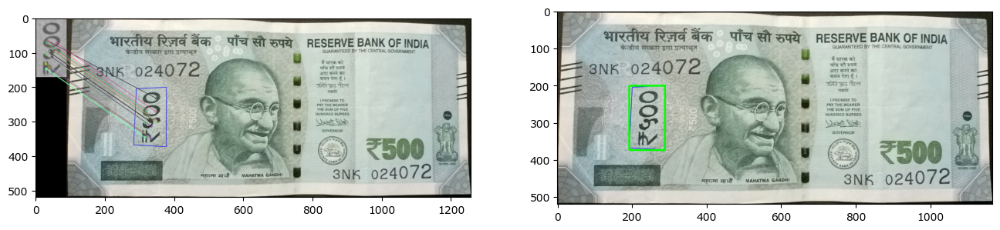

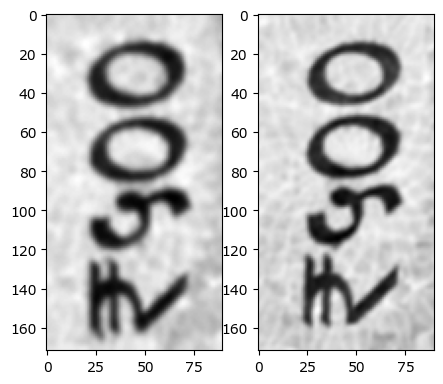

SSIM score:  0.6266919043407881 

SSIM score set of Feature 1:  [np.float64(0.8912461747428234), np.float64(0.5593300631270272), np.float64(0.6664040505847512), np.float64(0.6833000133892703), np.float64(0.5754926361671558), np.float64(0.6266919043407881)] 

Average SSIM of Feature 1:  0.6670774737253028 

Average SSIM of Feature 1:  0.6670774737253028 

ANALYSIS OF FEATURE 2
---> Template 1 :


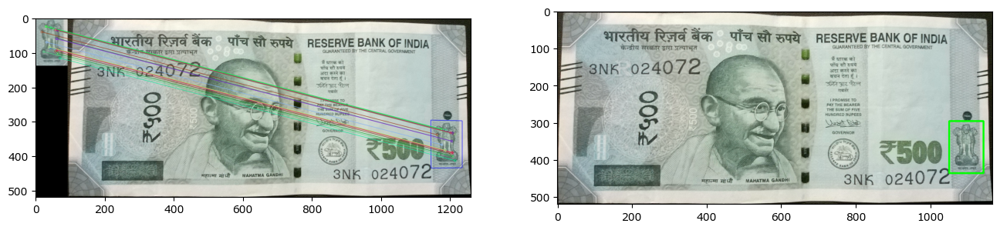

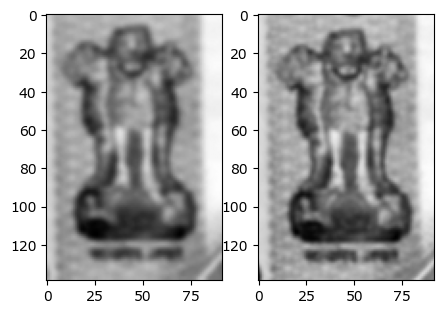

SSIM score:  0.7415082845441018 

---> Template 2 :


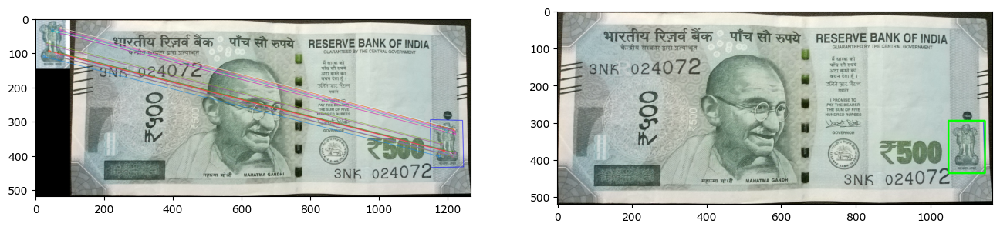

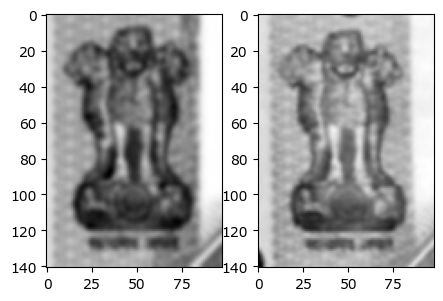

SSIM score:  0.7271533966332006 

---> Template 3 :


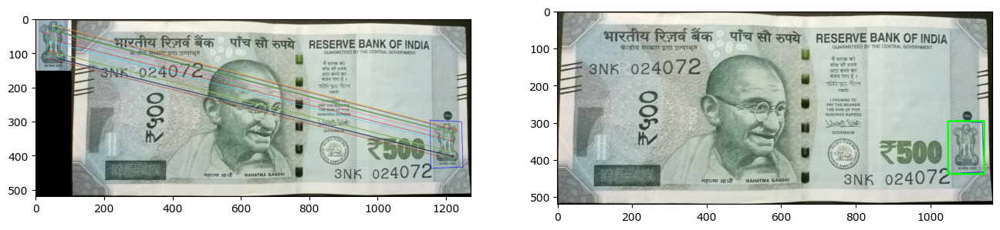

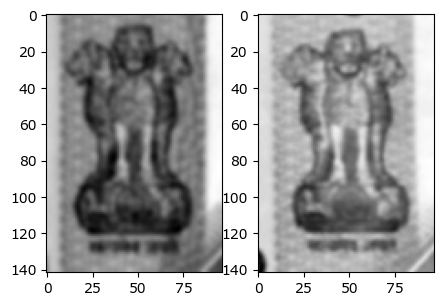

SSIM score:  0.5983131112997623 

---> Template 4 :
Template Discarded- Area of extracted feature is outside permitted range!
---> Template 5 :


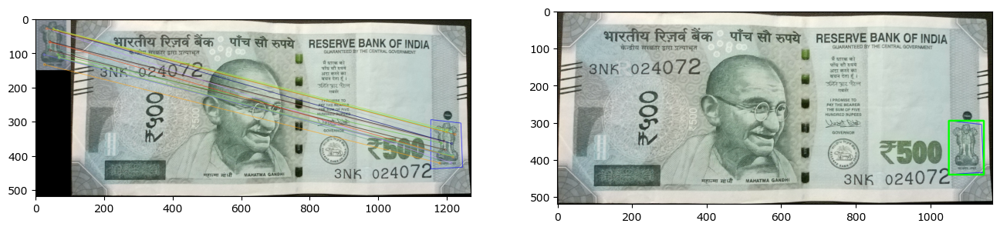

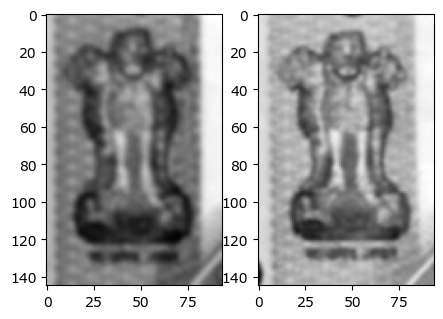

SSIM score:  0.6668391650535224 

---> Template 6 :
Template Discarded- Area of extracted feature is outside permitted range!
SSIM score set of Feature 2:  [np.float64(0.7415082845441018), np.float64(0.7271533966332006), np.float64(0.5983131112997623), np.float64(0.6668391650535224)] 

Average SSIM of Feature 2:  0.6834534893826467 

Average SSIM of Feature 2:  0.6834534893826467 

ANALYSIS OF FEATURE 3
---> Template 1 :


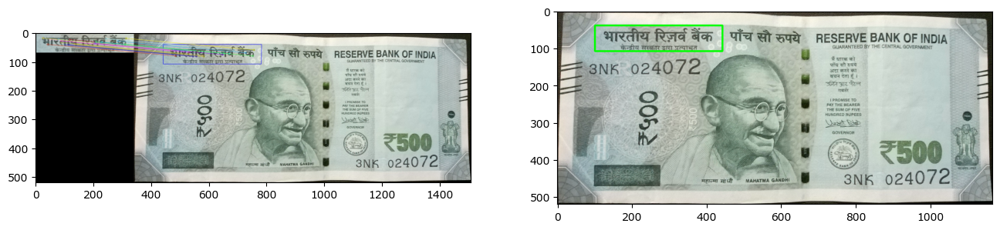

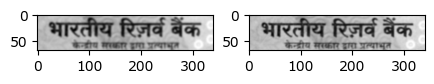

SSIM score:  0.9303194197148493 

---> Template 2 :


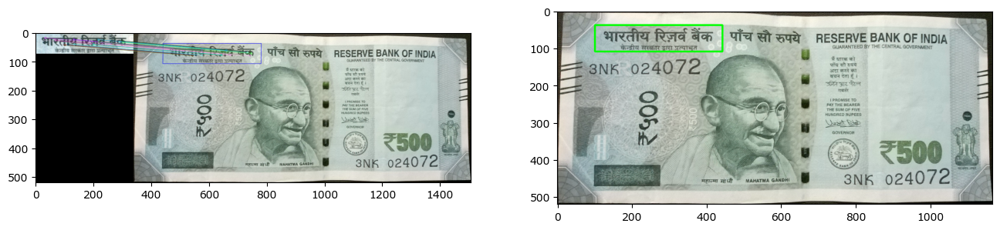

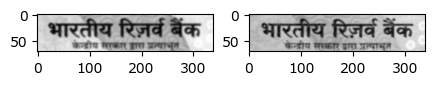

SSIM score:  0.7387092512190235 

---> Template 3 :


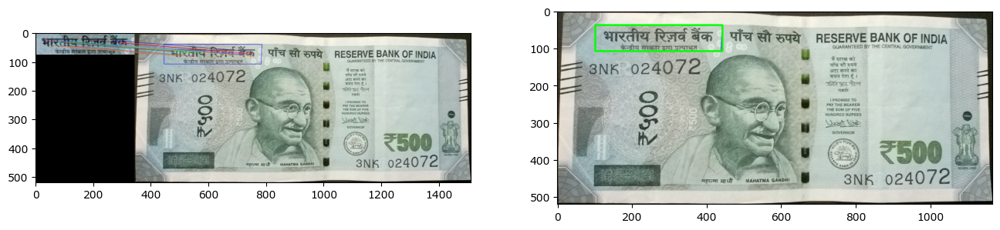

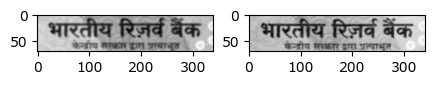

SSIM score:  0.7617390987893478 

---> Template 4 :


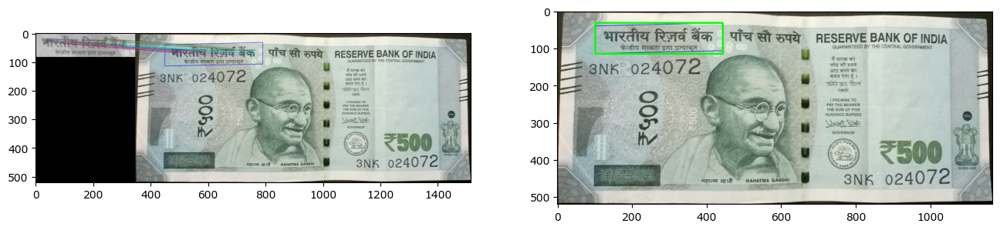

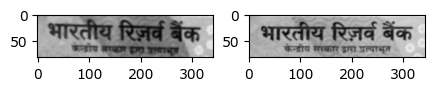

SSIM score:  0.6325062711937254 

---> Template 5 :


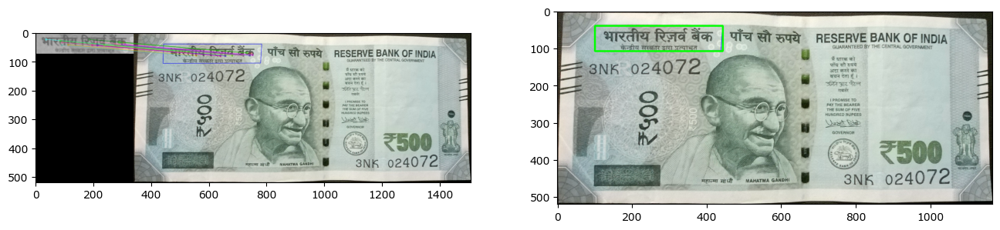

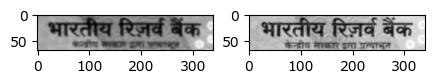

SSIM score:  0.7101146149898869 

---> Template 6 :


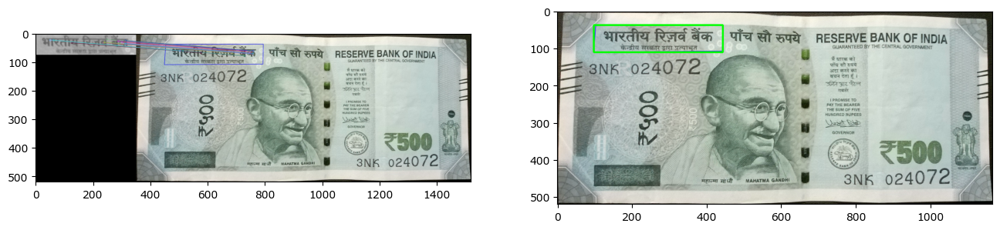

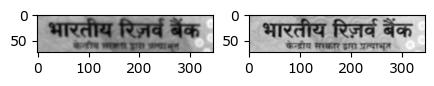

SSIM score:  0.6032200375566238 

SSIM score set of Feature 3:  [np.float64(0.9303194197148493), np.float64(0.7387092512190235), np.float64(0.7617390987893478), np.float64(0.6325062711937254), np.float64(0.7101146149898869), np.float64(0.6032200375566238)] 

Average SSIM of Feature 3:  0.7294347822439095 

Average SSIM of Feature 3:  0.7294347822439095 

ANALYSIS OF FEATURE 4
---> Template 1 :


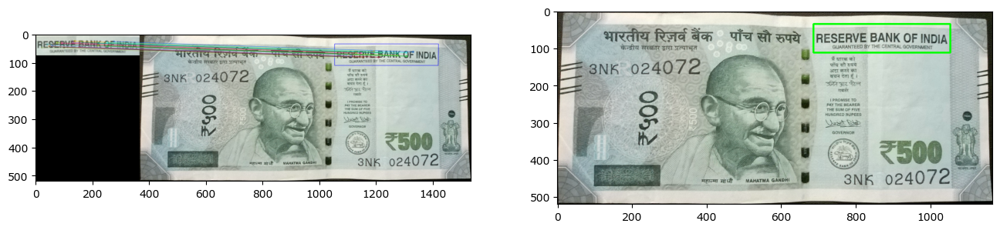

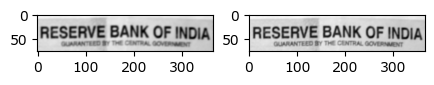

SSIM score:  0.8896054841041885 

---> Template 2 :


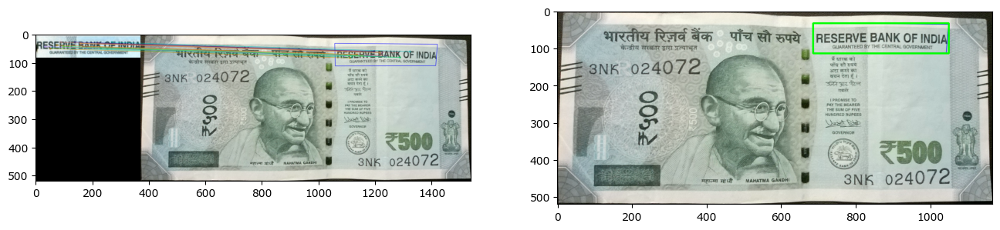

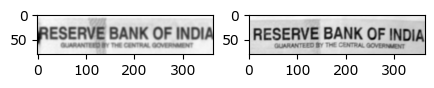

SSIM score:  0.4305669652531494 

---> Template 3 :


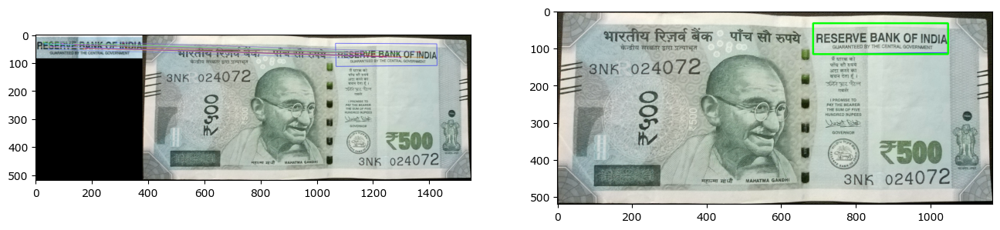

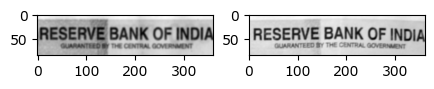

SSIM score:  0.4399783562349604 

---> Template 4 :


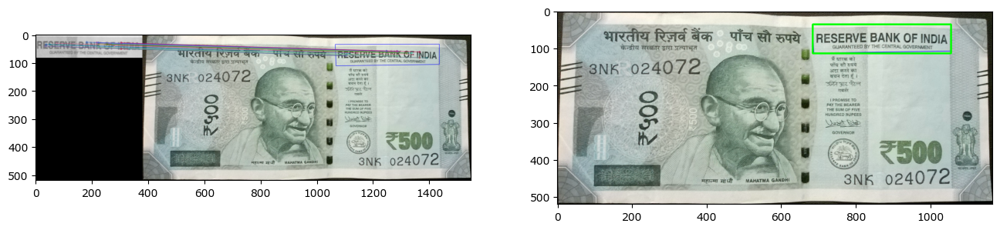

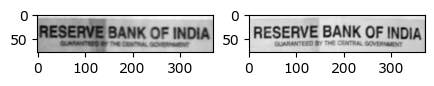

SSIM score:  0.47313092219734726 

---> Template 5 :


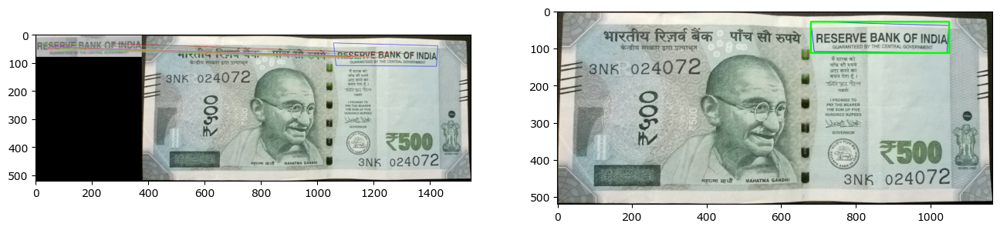

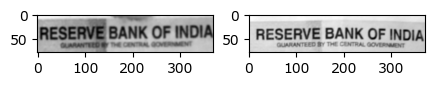

SSIM score:  0.39267377897189387 

---> Template 6 :


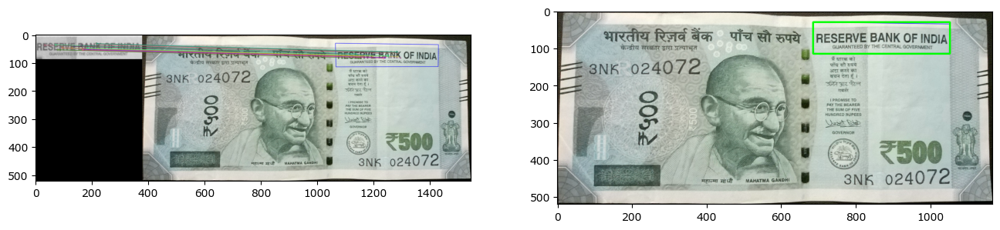

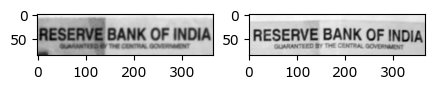

SSIM score:  0.4349414718789132 

SSIM score set of Feature 4:  [np.float64(0.8896054841041885), np.float64(0.4305669652531494), np.float64(0.4399783562349604), np.float64(0.47313092219734726), np.float64(0.39267377897189387), np.float64(0.4349414718789132)] 

Average SSIM of Feature 4:  0.5101494964400755 

Average SSIM of Feature 4:  0.5101494964400755 

ANALYSIS OF FEATURE 5
---> Template 1 :


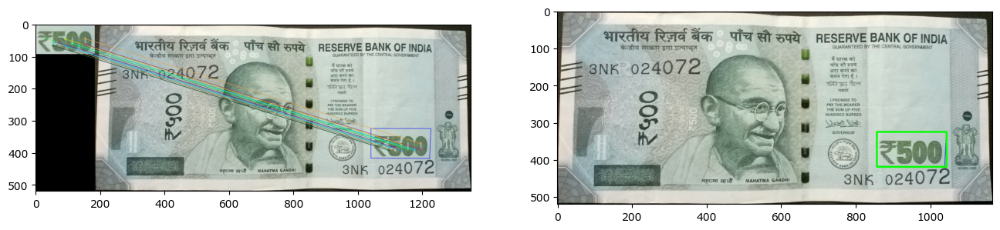

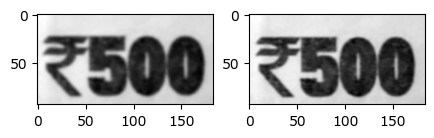

SSIM score:  0.9040346294993397 

---> Template 2 :


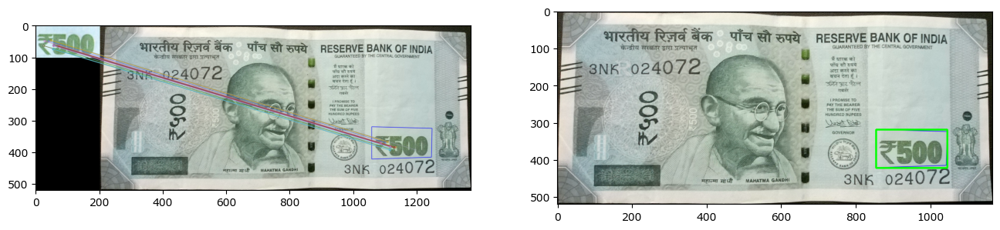

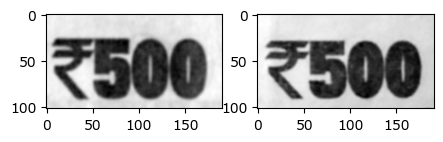

SSIM score:  0.5751618053490091 

---> Template 3 :


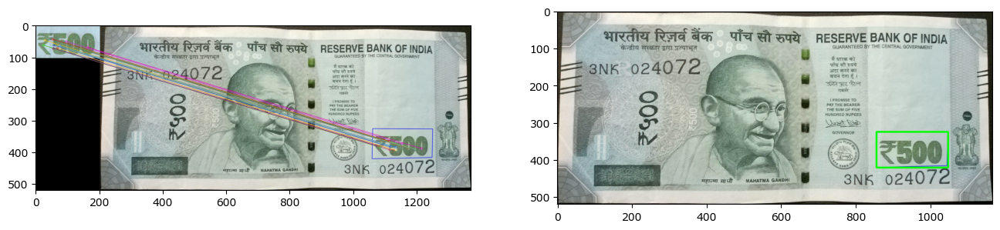

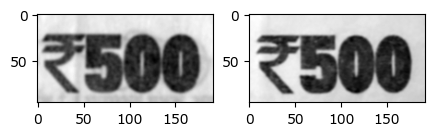

SSIM score:  0.7279481664794695 

---> Template 4 :


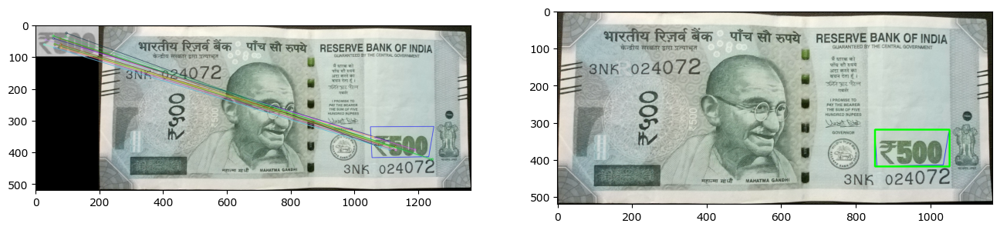

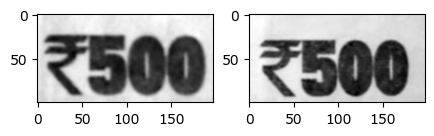

SSIM score:  0.5721742873040747 

---> Template 5 :


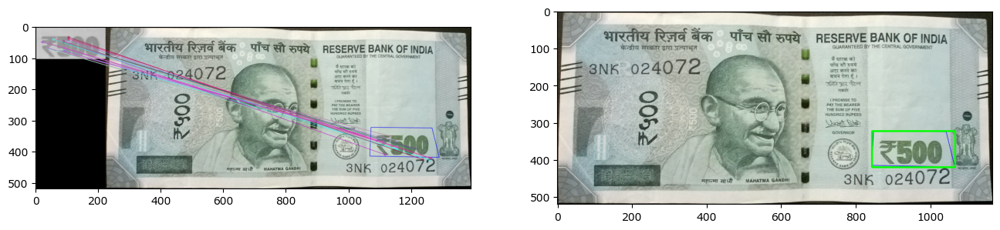

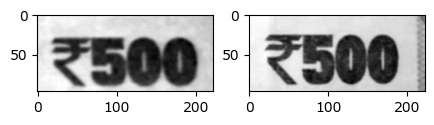

SSIM score:  0.5985789617020845 

---> Template 6 :


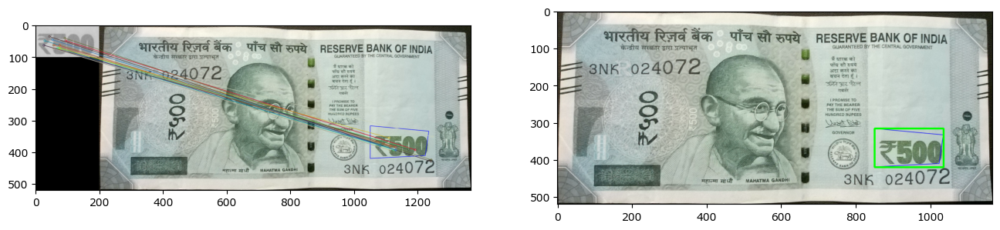

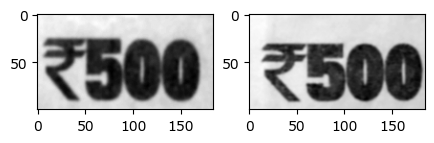

SSIM score:  0.4434174938252517 

SSIM score set of Feature 5:  [np.float64(0.9040346294993397), np.float64(0.5751618053490091), np.float64(0.7279481664794695), np.float64(0.5721742873040747), np.float64(0.5985789617020845), np.float64(0.4434174938252517)] 

Average SSIM of Feature 5:  0.6368858906932048 

Average SSIM of Feature 5:  0.6368858906932048 

ANALYSIS OF FEATURE 6
---> Template 1 :


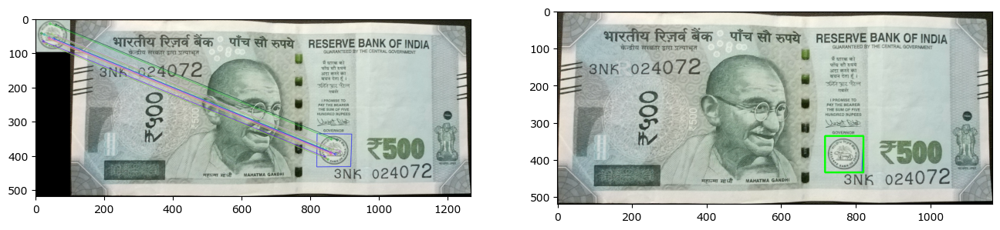

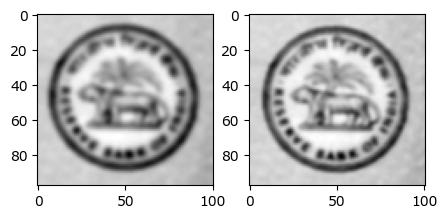

SSIM score:  0.863377976361076 

---> Template 2 :


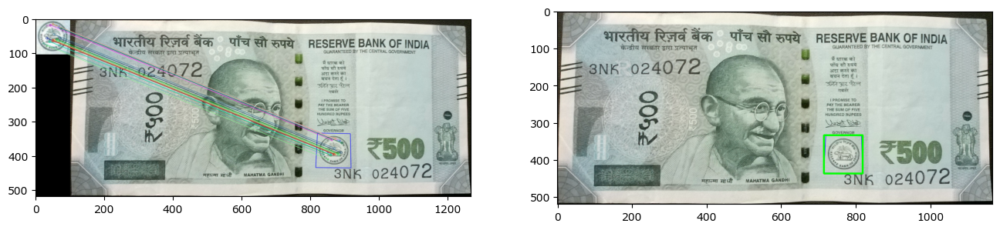

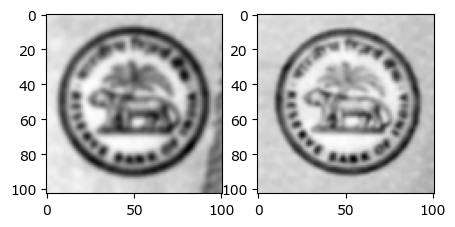

SSIM score:  0.689448986687532 

---> Template 3 :


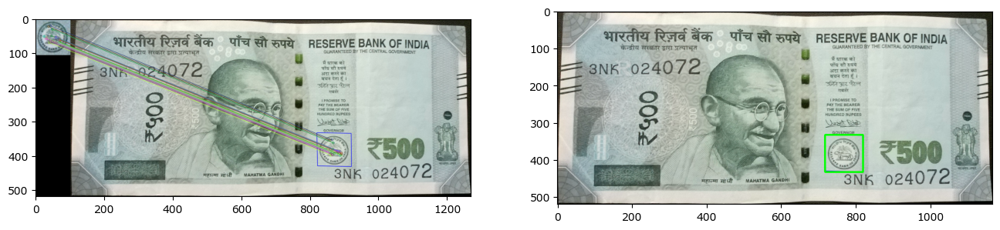

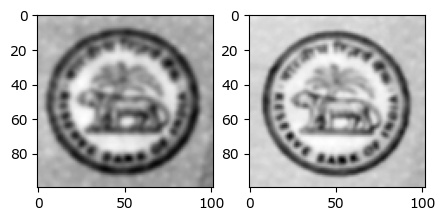

SSIM score:  0.7068904842371025 

---> Template 4 :


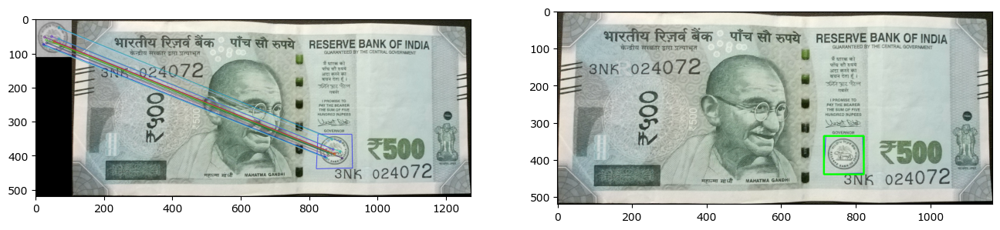

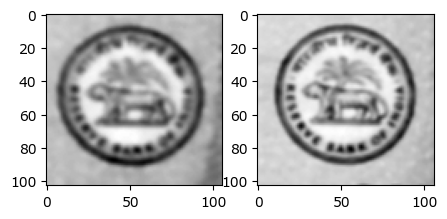

SSIM score:  0.6816776036552488 

---> Template 5 :
Template Discarded- Area of extracted feature is outside permitted range!
---> Template 6 :


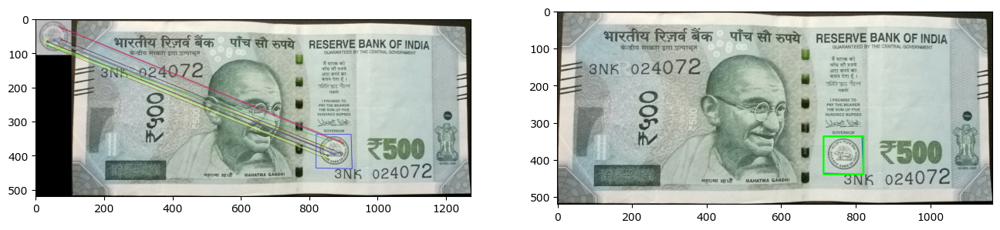

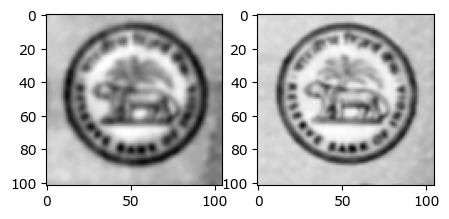

SSIM score:  0.8382189874056876 

SSIM score set of Feature 6:  [np.float64(0.863377976361076), np.float64(0.689448986687532), np.float64(0.7068904842371025), np.float64(0.6816776036552488), np.float64(0.8382189874056876)] 

Average SSIM of Feature 6:  0.7559228076693293 

Average SSIM of Feature 6:  0.7559228076693293 

ANALYSIS OF FEATURE 7
---> Template 1 :


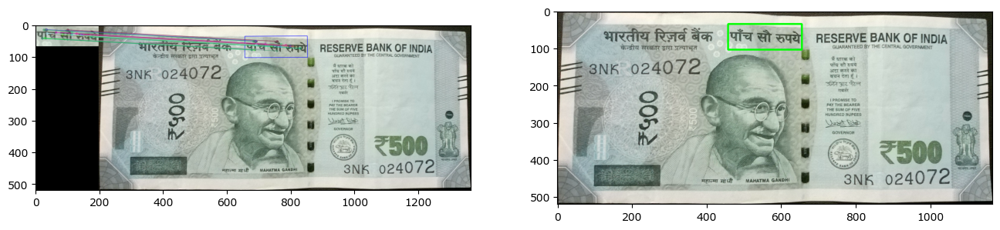

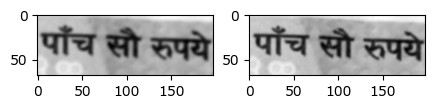

SSIM score:  0.9125904901479721 

---> Template 2 :


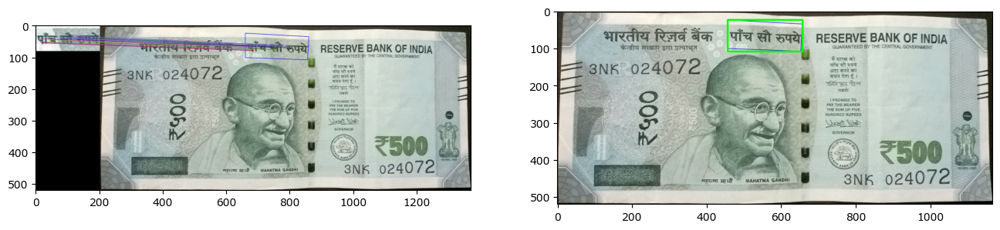

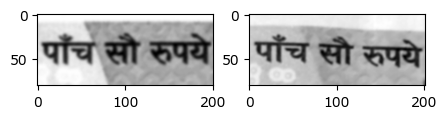

SSIM score:  0.5150604725110061 

---> Template 3 :


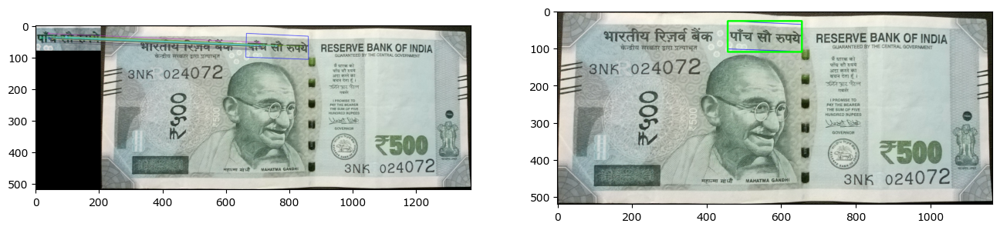

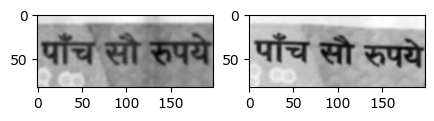

SSIM score:  0.48913573395509513 

---> Template 4 :


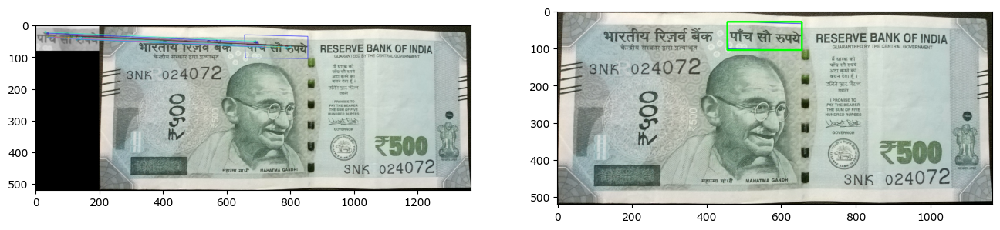

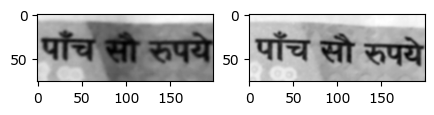

SSIM score:  0.5818415395749149 

---> Template 5 :


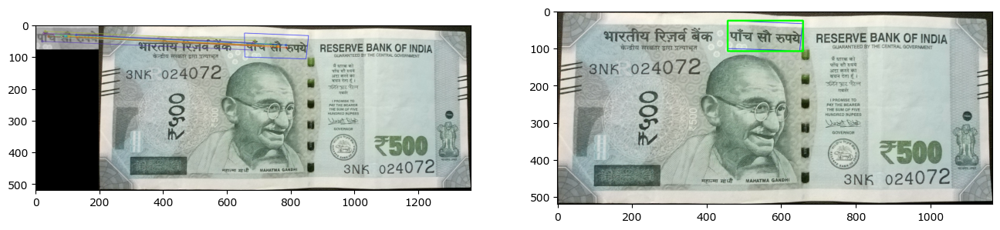

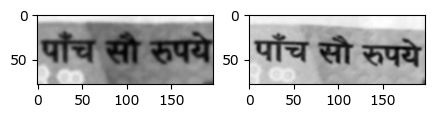

SSIM score:  0.5834217973124327 

---> Template 6 :


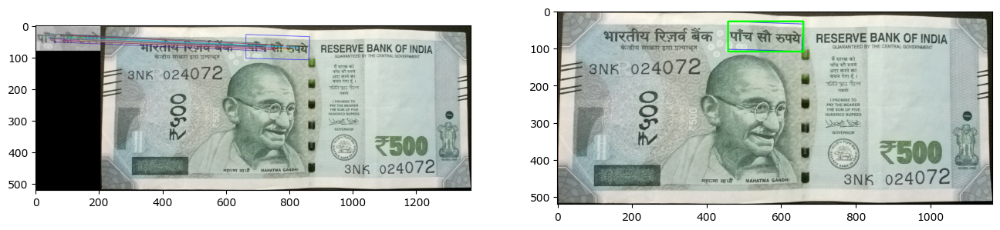

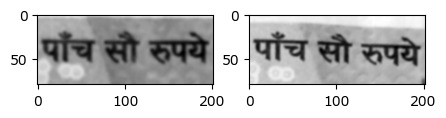

SSIM score:  0.5901677463311986 

SSIM score set of Feature 7:  [np.float64(0.9125904901479721), np.float64(0.5150604725110061), np.float64(0.48913573395509513), np.float64(0.5818415395749149), np.float64(0.5834217973124327), np.float64(0.5901677463311986)] 

Average SSIM of Feature 7:  0.6120362966387699 

Average SSIM of Feature 7:  0.6120362966387699 

Final Score- set list: 

Feature 1 : [np.float64(0.8912461747428234), np.float64(0.5593300631270272), np.float64(0.6664040505847512), np.float64(0.6833000133892703), np.float64(0.5754926361671558), np.float64(0.6266919043407881)]
Feature 2 : [np.float64(0.7415082845441018), np.float64(0.7271533966332006), np.float64(0.5983131112997623), np.float64(0.6668391650535224)]
Feature 3 : [np.float64(0.9303194197148493), np.float64(0.7387092512190235), np.float64(0.7617390987893478), np.float64(0.6325062711937254), np.float64(0.7101146149898869), np.float64(0.6032200375566238)]
Feature 4 : [np.float64(0.8896054841041885), np.float64(0.43056696

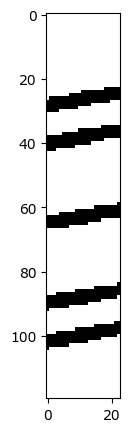

Number of black regions found in each column: 
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5

Number of columns examined:  23
Number of non- erroneous columns found:  23

Average number of black regions is:  5.0

ANALYSIS OF FEATURE 9 : RIGHT BLEED LINES



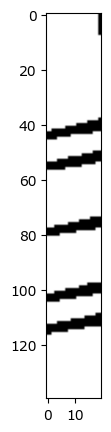

Number of black regions found in each column: 
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5

Number of columns examined:  20
Number of non- erroneous columns found:  20

Average number of black regions is:  5.0


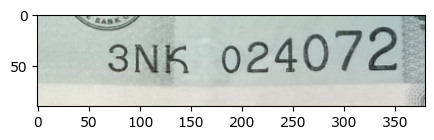


ANALYSIS OF FEATURE 10 : NUMBER PANEL 

---> Threshold 1 with Threshold value 95 :
Unsuccessful!
---> Threshold 4 with Threshold value 100 :
Unsuccessful!
---> Threshold 7 with Threshold value 105 :
Unsuccessful!
---> Threshold 8 with Threshold value 110 :
Test Successful: 9 letters found!
---> Threshold 10 with Threshold value 115 :
Test Successful: 9 letters found!
---> Threshold 10 with Threshold value 120 :
Test Successful: 9 letters found!
Test Passed!- 9 characters were detected in the serial number panel.


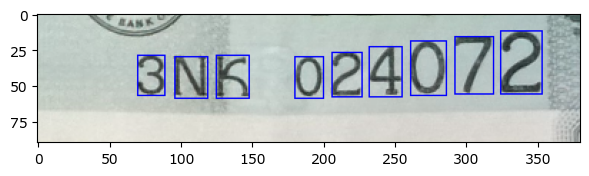



RESULT ANALYSIS

Feature 1: Successful
Feature 2: Successful
Feature 3: Successful
Feature 4: Successful
Feature 5: Successful
Feature 6: Successful
Feature 7: Successful
Feature 8: Successful- 5 bleed lines found in left part of currency note
Feature 9: Successful- 5 bleed lines found in right part of currency note
Feature 10: Successful- 9 characters found in number panel of currency note

Result Summary:
10 out of 10 features are VERIFIED!


In [ ]:

def Testing():   
    button.config(state = DISABLED)
    result_list.clear()
    preprocessing()
    testFeature_1_2_7()
    testFeature_8()
    testFeature_9()
    testFeature_10()
    testResult()
    progress['value']=100
    ProgressWin.update_idletasks()
    time.sleep(0.8)
    ProgressWin.destroy()

def exitGUI():
    ProgressWin.destroy()

ProgressWin = Tk() 
ProgressWin.title("Processing Image")
ProgressWin.title('Fake Currency Detection - Processing')

ProgressWin.resizable(False, False) 

window_height = 200
window_width = 500

screen_width = ProgressWin.winfo_screenwidth()
screen_height = ProgressWin.winfo_screenheight()

x_cordinate = int((screen_width/2) - (window_width/2))
y_cordinate = int((screen_height/2) - (window_height/2))

ProgressWin.geometry("{}x{}+{}+{}".format(window_width, window_height, x_cordinate, y_cordinate))



main_frame=Frame(ProgressWin,relief=GROOVE)
main_frame.place(x=10,y=10) 


frame1 = Frame(main_frame, padx=3, pady=3)
frame2 = Frame(main_frame, bg='dark blue', pady=5, padx = 5)
frame3 = Frame(main_frame, pady=5, padx = 5)

frame1.grid(row = 1, column = 1, padx = 5, pady = 5)
frame2.grid(row = 2, column = 1, padx = 5, pady = 5)
frame3.grid(row = 3, column = 1, padx = 5, pady = 30)


label = Label(master=frame1, text="Processing! Please wait...", fg = 'green', font = "Verdana 13 bold")
label.pack() 

progress = Progressbar(frame2, orient = HORIZONTAL, length = 450, mode = 'determinate') 
progress.pack()

button = Button(frame3, text = 'Click to continue', command = Testing, font = "Verdana 12 bold", pady = 5)
button.pack()


ProgressWin.mainloop()

In [21]:
# Store the list containing the final result of each feature

%store result_list

Stored 'result_list' (list)
